In [1]:
from pathlib import Path
from datetime import datetime, timedelta

import cartopy
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
from matplotlib.animation import ArtistAnimation
from matplotlib.colors import Normalize
from metpy.plots import USSTATES, USCOUNTIES, ctables, colortables
import numpy as np
from siphon.catalog import TDSCatalog
from siphon.cdmr import Dataset
from siphon.radarserver import RadarServer
from datetime import datetime
from dateutil import tz

In [2]:
cat = TDSCatalog('https://thredds.ucar.edu/thredds/radarServer/catalog.xml')

In [3]:
rs = RadarServer(cat.catalog_refs['NEXRAD Level III Radar from IDD'].href)

In [7]:
station = 'TLH'
query = rs.query()
now = datetime.utcnow()
query.stations(station).time_range(now - timedelta(hours=1), now).variables('N0Q')

var=N0Q&time_start=2022-06-27T20%3A20%3A21.863717&time_end=2022-06-27T21%3A20%3A21.863717&stn=TLH

In [8]:
query_cat = rs.get_catalog(query)

In [9]:
print(sorted(query_cat.datasets))

[]


In [29]:
def plot_radar(data, field_name):
    rng = data.variables['gate'][:]
    az = data.variables['azimuth'][:]
    ref = data.variables[field_name][:]
    
    offset_in_degrees_latitude = 1.7
    offset_in_degrees_longitude = 3.4
    ax.set_extent([data.RadarLongitude - offset_in_degrees_longitude,
                   data.RadarLongitude + offset_in_degrees_longitude,
                   data.RadarLatitude - offset_in_degrees_latitude,
                   data.RadarLatitude + offset_in_degrees_latitude])
                   
    ax.set_adjustable('datalim')
    
    x = rng * np.sin(np.deg2rad(az))[:, None]
    y = rng * np.cos(np.deg2rad(az))[:, None]
    
    #cmap = colortables.get_colortable('NWSReflectivity')
    norm, cmap = ctables.registry.get_with_steps('NWSStormClearReflectivity', 20, 5)
    
    mesh = ax.pcolormesh(x, y, ref, cmap=cmap, norm=Normalize(-30, 80), zorder=0,)
    
    return mesh

    
def convert_datetime_to_local(string):
    from_zone = tz.gettz('UTC')
    to_zone = tz.gettz('America/New_York')
    utc_time = datetime.strptime(string, '%Y-%m-%dT%H:%M:%SZ').replace(tzinfo=from_zone)
    eastern = utc_time.astimezone(to_zone)
    date_time = datetime.strftime(eastern, '%a, %b %d, %Y %I:%M %p').lstrip('0').replace(' 0', ' ')
    return date_time

In [30]:
field_name = 'BaseReflectivityDR'
base_file = query_cat.datasets[0].remote_access()
proj = cartopy.crs.LambertConformal(central_longitude=base_file.RadarLongitude,
                                    central_latitude=base_file.RadarLatitude)

county_borders = USCOUNTIES.with_scale('20m')

/Users/rhawthorne/miniconda3/envs/metpy/lib/python3.7/site-packages/cartopy/mpl/geoaxes.py:1598: UserWarning: The input coordinates to pcolormesh are interpreted as cell centers, but are not monotonically increasing or decreasing. This may lead to incorrectly calculated cell edges, in which case, please supply explicit cell edges to pcolormesh.
  shading=shading)


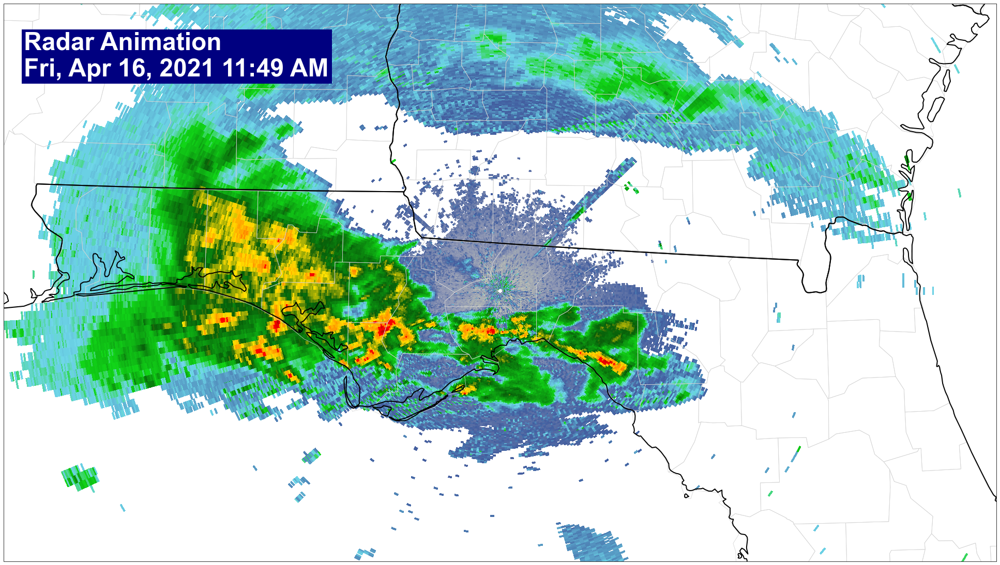

In [31]:
fig = plt.figure(figsize=(1920/72, 1080/72))
ax = fig.add_axes([0, 0, 1, 1], projection=proj)

artists = []

ax.add_feature(cfeature.STATES.with_scale('10m'), linewidth=2, zorder=2)
ax.add_feature(county_borders, edgecolor='lightgray', zorder=1, linewidth=0.75)

for ds_name in sorted(query_cat.datasets):
    ds = query_cat.datasets[ds_name]
    data = Dataset(ds.access_urls['CdmRemote'])
    
    field_name = [var.name for var in data.variables.values()
                  if var.ndim >=2 and not var.name.endswith('RAW')][0]
    
    text = ax.text(0.02, 0.95, s=f'Radar Animation\n{convert_datetime_to_local(data.time_coverage_start)}',
                   fontsize=48, fontweight='bold', fontname='Arial',
                   color='white', bbox={'facecolor':'navy', 'alpha':1.0, 'edgecolor': 'none'},
                   transform=ax.transAxes, zorder=10, va='top')
    
    mesh = plot_radar(data, field_name)
    
    artists.append([text, mesh])

In [32]:
plt.rcParams['animation.html'] = 'jshtml'

In [33]:
anim = ArtistAnimation(fig, artists, interval=150, repeat_delay=2000)
anim

In [34]:
graphics_dir = Path('.') / '..' / '..' / 'graphics' / 'radar'
anim.save(f'{graphics_dir}/{station}_radar_animation.gif', writer='pillow')